In [80]:
import warnings
#warnings.simplefilter("ignore")
import pandas as pd
import numpy as np
import sklearn as sk
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score, cross_val_predict, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.svm import SVC
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, confusion_matrix, classification_report, roc_curve
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imPipeline
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
import matplotlib.gridspec as gridspec

# **Introduction**
The data science problem that we are trying to solve is predicting whether or not an employee will choose to leave a company based on their profile. This is classification of an employee’s attrition status based on demographic information, work history, and job details. This problem is important because high attrition rates mean companies are losing talented workers and must constantly expend resources to hire and train new employees. Using our model, a company could try to predict whether a given employee has a high chance of wanting to leave the company and incentivize the employee to stay. Additionally, noticing the trends in employee attrition could allow the company to make company-wide changes to decrease the overall attrition rate.

To solve this problem, we’re using a fictional dataset created by IBM data scientists that includes HR information related to an employee’s work life, history, marital status, education, and more. Additionally, each employee has a label corresponding to the employee’s attrition. There are 34 features in this dataset, which include information such as age, gender, marital status, monthly income, and the number of years at the company. Using this dataset, we would like to be able to predict whether an employee will leave the company based on their profile.

## Ordinal Attributes
Education
1 'Below College'
2 'College'
3 'Bachelor'
4 'Master'
5 'Doctor'

EnvironmentSatisfaction
1 'Low'
2 'Medium'
3 'High'
4 'Very High'

JobInvolvement
1 'Low'
2 'Medium'
3 'High'
4 'Very High'

JobSatisfaction
1 'Low'
2 'Medium'
3 'High'
4 'Very High'

PerformanceRating
1 'Low'
2 'Good'
3 'Excellent'
4 'Outstanding'

RelationshipSatisfaction
1 'Low'
2 'Medium'
3 'High'
4 'Very High'

WorkLifeBalance
1 'Bad'
2 'Good'
3 'Better'
4 'Best'


In [4]:
data = pd.read_csv("employee_attrition.csv")
print(data.shape)
data.head()

(1470, 35)


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


# A. Data prep
  

## Checking for null values and duplicate records
We first wanted to see if there were any null values in our dataset, which we checked by finding the number of null values for each feature.

In [5]:
data.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

We saw that our dataset didn't contain any null values. We then used a function to drop duplicate rows from our dataframe, though we saw that there were no duplicate rows since the shape of the dataframe stayed the same.

In [6]:
# Drop duplicates
print("Before drop duplicates: ", data.shape)
data = data.drop_duplicates()
print("After drop duplicates: ", data.shape)
data.head()

Before drop duplicates:  (1470, 35)
After drop duplicates:  (1470, 35)


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


## Split features and labels
We then separated the column with the attrition status label from the features columns so that we could use this data with the scikit-learn models.

In [7]:
features = data.loc[:, data.columns != 'Attrition']
labels = data['Attrition']

## Remove irrelevant features
For the final piece of preparation before we explored the data, we decided to remove any columns with a single value. This is because a feature with only one possible value doesn't provide any differentiating information. 

In [8]:
drop_f = []
for c in features:
  count = features[c].value_counts().shape[0]
  if count == 1:
      drop_f.append(c)

drop_f

['EmployeeCount', 'Over18', 'StandardHours']

We saw that there were three features that only had one value: EmployeeCount, Over19, StandardHours. We then removed these columns from the dataframe.  

In [9]:
# Remove features found in drop_f
features.drop(drop_f, axis=1, inplace=True)
features.head()

/home/daniel/.local/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,Female,...,3,1,0,8,0,1,6,4,0,5
1,49,Travel_Frequently,279,Research & Development,8,1,Life Sciences,2,3,Male,...,4,4,1,10,3,3,10,7,1,7
2,37,Travel_Rarely,1373,Research & Development,2,2,Other,4,4,Male,...,3,2,0,7,3,3,0,0,0,0
3,33,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,5,4,Female,...,3,3,0,8,3,3,8,7,3,0
4,27,Travel_Rarely,591,Research & Development,2,1,Medical,7,1,Male,...,3,4,1,6,3,3,2,2,2,2


'EmployeeNumber' also doesn't provide information for the employees because it's a random ID, so we removed this column. 

In [10]:
# Remove irrelevant columns
remove_cols = ['EmployeeNumber']
features.drop(remove_cols, axis=1, inplace=True)
features.head()

/home/daniel/.local/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Travel_Rarely,1102,Sales,1,2,Life Sciences,2,Female,94,...,3,1,0,8,0,1,6,4,0,5
1,49,Travel_Frequently,279,Research & Development,8,1,Life Sciences,3,Male,61,...,4,4,1,10,3,3,10,7,1,7
2,37,Travel_Rarely,1373,Research & Development,2,2,Other,4,Male,92,...,3,2,0,7,3,3,0,0,0,0
3,33,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,4,Female,56,...,3,3,0,8,3,3,8,7,3,0
4,27,Travel_Rarely,591,Research & Development,2,1,Medical,1,Male,40,...,3,4,1,6,3,3,2,2,2,2


# B. Data Exploration


## Understanding the numbers
To get a broad idea of what the dataset and values for each feature looked like, we took a look at the mean, median, and standard deviation for each feature. We also printed the numbers of records in each class for this dataset so we can check for class imbalance.

In [11]:
# Mean and Std Dev. for all features
print(labels.value_counts())
features.agg(['mean','median','std'])

No     1233
Yes     237
Name: Attrition, dtype: int64


,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
mean,36.923810,802.485714,9.192517,2.912925,2.721769,65.891156,2.729932,2.063946,2.728571,6502.931293,...,3.153741,2.712245,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
median,36.000000,802.000000,7.000000,3.000000,3.000000,66.000000,3.000000,2.000000,3.000000,4919.000000,...,3.000000,3.000000,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
std,9.135373,403.509100,8.106864,1.024165,1.093082,20.329428,0.711561,1.106940,1.102846,4707.956783,...,0.360824,1.081209,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136


From this, we could see that 84% of the employees in this dataset stayed with the company, resulting in a class imbalance that we would need to address when creating our model.

## Look at histograms of data
To get a better picture of the data, we generated histograms for each feature, showing the number of records with each possible feature value.

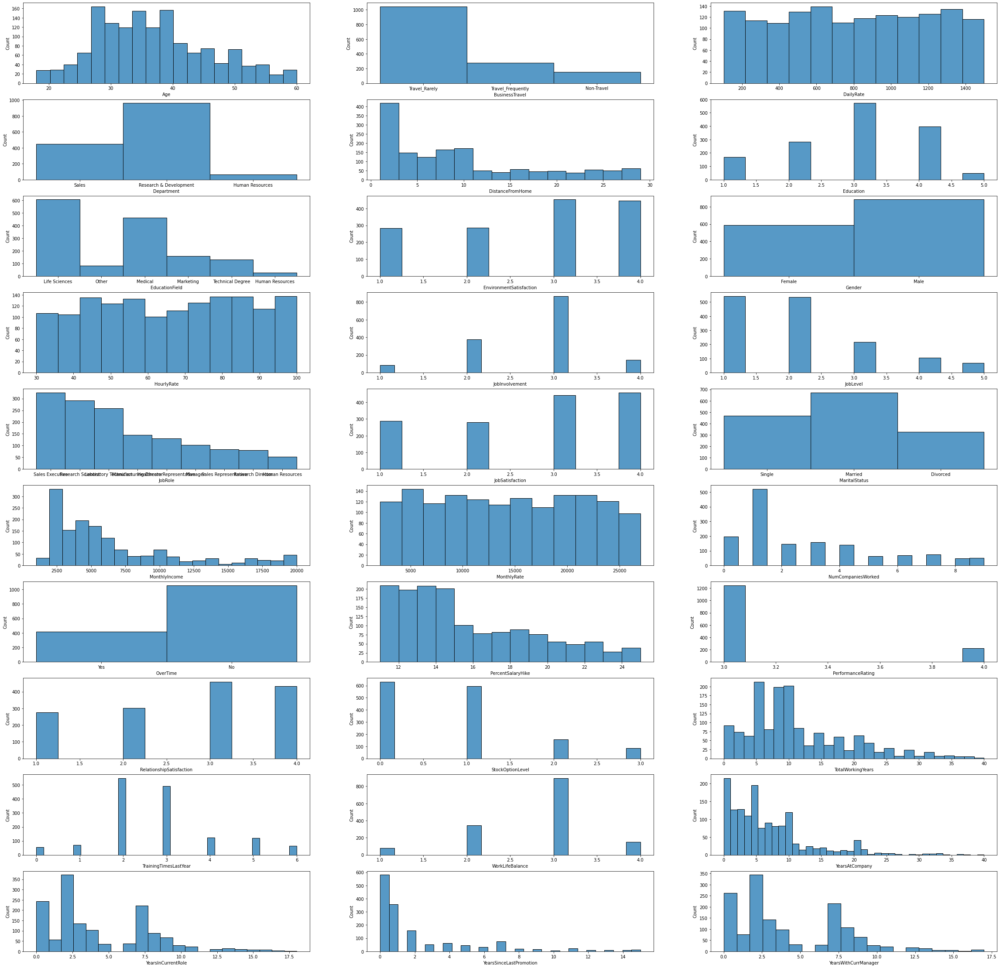

In [12]:
# Look at histograms
fig, axs = plt.subplots(10, 3, figsize=(40, 40))
axs = axs.flatten()
for i, c in enumerate(features):
  sns.histplot(x=c, data=features, ax=axs[i])

plt.show()

## Look at Correlations
We decided to generate a correlation matrix for the features. We thought we'd be able to remove some of the features regarding each employee's rate (DailyRate, HourlyRate, MonthlyRate), since it seemed that these features would contain the same information at different time scales. We also thought there might be correlation between each employee's monthly income and monthly rate. To confirm these suspicions, we wanted to look at the correlations between the different features.

<AxesSubplot:>

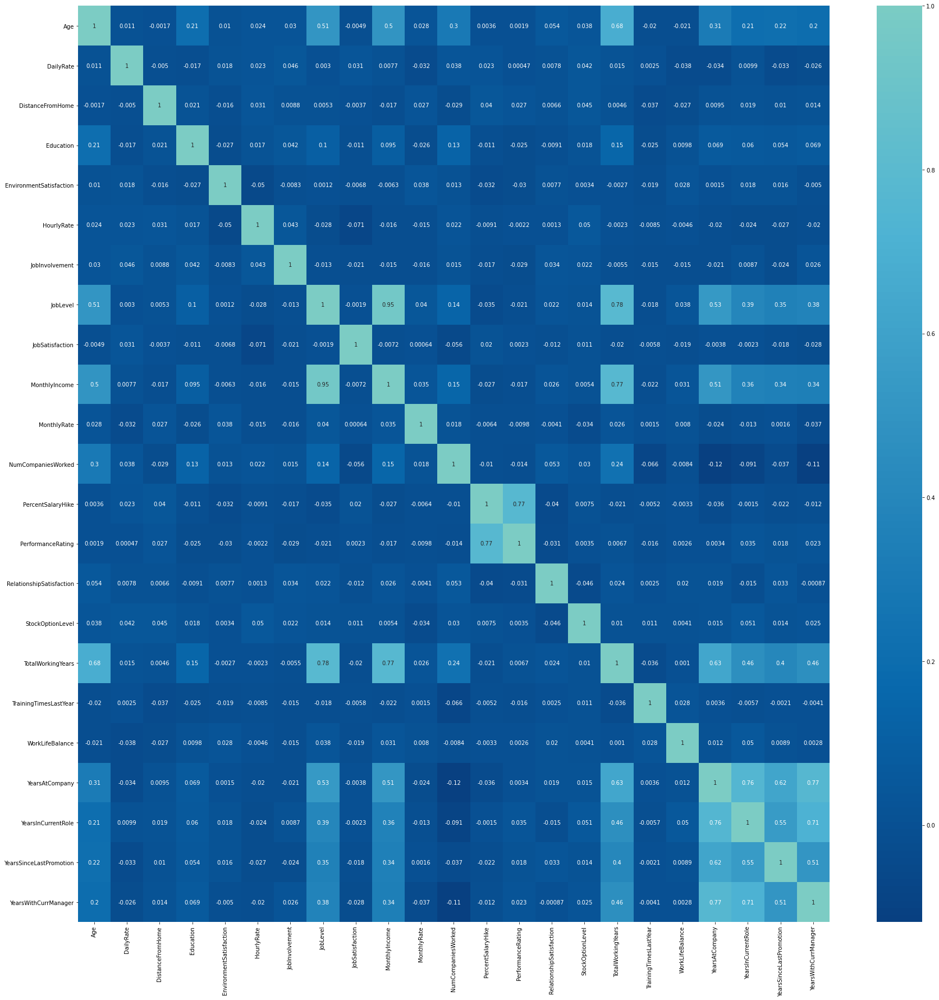

In [13]:
correlations = features.corr(method='pearson')
fig = plt.figure(figsize=(30, 30))

sns.heatmap(correlations, annot=True, cmap='GnBu_r', center=1)

After checking the correlation heatmap, we saw that the different rate features were not correlated with each other, nor were they correlated with monthly income. Based on this information, we decided to keep the different rate features.

We also noticed that JobLevel and MonthlyIncome are highly correlated. However, because JobLevel differentiates tiers amongst employees with the same job roles (JobRole), we decided not to drop either feature.

## Graphs for Attrition vs. Features
We then wanted to look at the relationship between different feature values and attrition rates. We divided the features up into five feature groups: satisfaction, job specifics, demographics, income, and work history with the current company.

### Satisfaction vs. Attrition
For the satisfaction category, we looked at the following features: WorkLifeBalance, RelationshipSatisfaction, JobSatisfaction, EnvironmentSatisfaction, and OverTime. For each feature, we graphed the number of records with each value by attrition status.

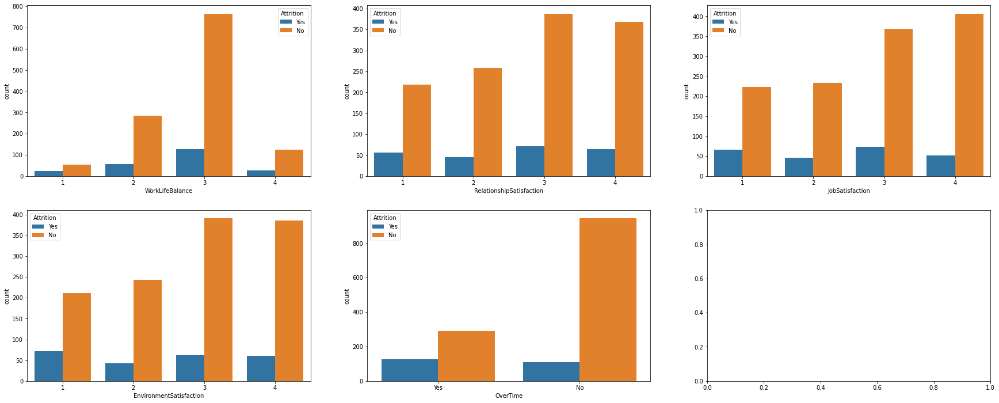

In [14]:
fig, axs = plt.subplots(2, 3, figsize=(30, 12))
axs = axs.flatten()
satisfaction = ["WorkLifeBalance", 
                "RelationshipSatisfaction",
                "JobSatisfaction",
                "EnvironmentSatisfaction", 
                "OverTime"]
                
for i, f in enumerate(satisfaction):
  sns.countplot(x=f, hue='Attrition', data=data, ax=axs[i])
plt.show()


We  could see there is a much higher attrition rate in the population of employees who had to work overtime compared to the population of employees without overtime. As expected, we could also see that there are higher rates of attrition in the populations of employees with lower environment satisfaction, worse work-life balance, and lower job satisfaction.

<br />

### Job Specifics vs. Attrition
The next category of features we looked at was related to details about each employee's job, which included the following features: JobLevel, JobInvolvement, BusinessTravel, StockOptionLevel, NumCompaniesWorked, Department, and JobRole. We again graphed the number of records with each feature value by attrition status. For NumCompaniesWorked, we generated a Kernel Density Estimate (KDE) plot, since there was a higher range of possible values.

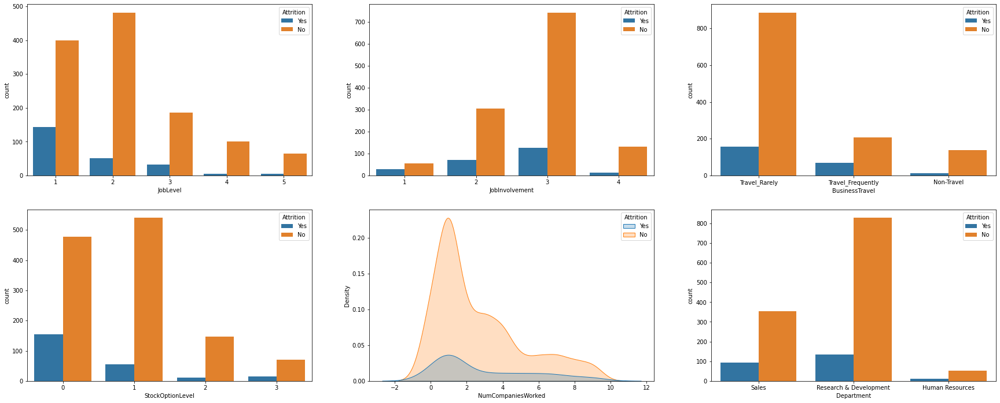

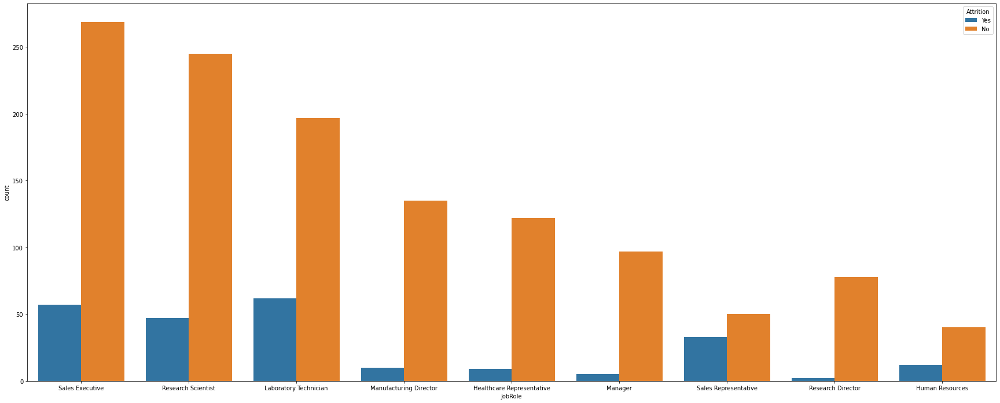

In [15]:
jobSpecifics = [ "JobLevel", "JobInvolvement", "BusinessTravel",
               "StockOptionLevel", "NumCompaniesWorked", "Department"]
fig, axs = plt.subplots(2, 3, figsize=(30, 12))
axs = axs.flatten()
for i, f in enumerate(jobSpecifics):
  if f == 'NumCompaniesWorked':
    sns.kdeplot(x=f, data=data, hue='Attrition', ax=axs[i], fill=True)
  else:
    sns.countplot(x=f, data=data, hue='Attrition', ax=axs[i])
plt.show()

fig, axs = plt.subplots(1, figsize=(30, 12))
sns.countplot(x='JobRole', data=data, hue='Attrition', ax=axs)
plt.show()

We could see the highest attrition rates in the employee populations with the lowest job level, lowest job involvement, and frequent travel. We could also see high attrition rates in the sales representative role.

<br />

### Demographics vs. Attrition
The next category of features that we looked at was demographics, which included the MaritalStatus, Gender, EducationField, Education, DistanceFromHome, and Age features. We generated KDE plots for DistanceFromHome and Age, and we plotted the other features by value and attrition status.

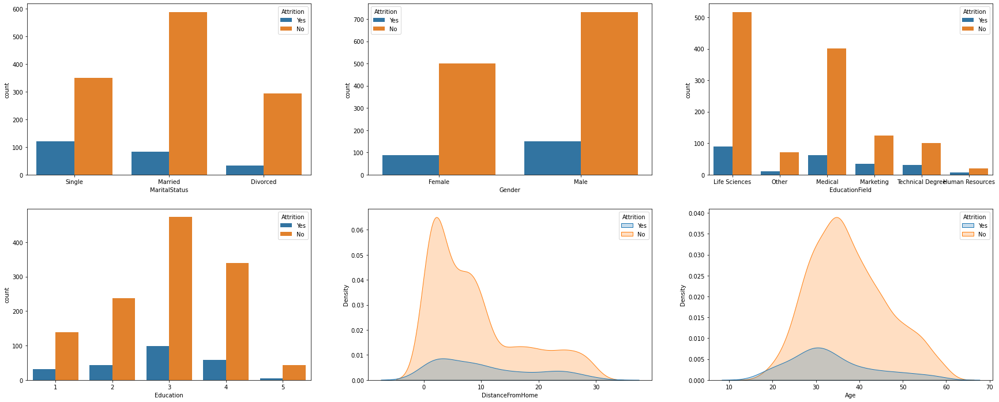

In [16]:
demography = ["MaritalStatus",
              "Gender",
              "EducationField",
              "Education",
              "DistanceFromHome",
              'Age']

fig, axs = plt.subplots(2, 3, figsize=(30, 12))
axs = axs.flatten()

for i, f in enumerate(demography):
  if f == 'DistanceFromHome' or f == 'Age':
    sns.kdeplot(x=f, data=data, hue='Attrition', ax=axs[i], fill=True)
  else:
    sns.countplot(x=f, data=data, hue='Attrition',ax=axs[i])
    
plt.show()

We could see that the population of single employees had a higher rate of attrition compared to married and divorced employees. There was also a higher proportion of employees who left the company in the population that had a farther distance from home compared to the population that was closer.

<br />

### Work history with company
We then looked at the features related to each employee's work history with the company: TrainingTimesLastYear, TotalWorkingYears, YearsAtCompany, YearsInCurrentRole, YearsSinceLastPromotion, and YearsWithCurrManager. We did this by creating paired box plots for each feature with TrainingTimesLastYear (since TrainingTimesLastYear is the only categorical feature in this group), separating the plots by attrition status.

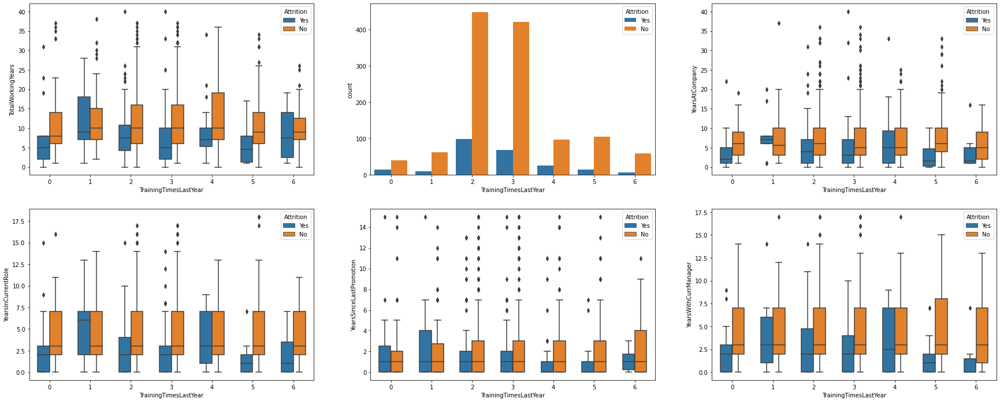

In [17]:
# do the same for TrainingTimesLastYear: boxplots
fig, axes = plt.subplots(2, 3, figsize=(30,12))
axes = axes.flatten()
sns.boxplot(x="TrainingTimesLastYear", y="TotalWorkingYears", hue="Attrition", 
    width=0.6, data=data, ax=axes[0])

# label the countplot with percentages within group
ax = sns.countplot(x="TrainingTimesLastYear", hue="Attrition", fill=True, 
            data=data, ax=axes[1])

totals = []
for v in set(data['TrainingTimesLastYear']):
    t = len(data.loc[data['TrainingTimesLastYear'] == v, :])
    totals.append(t)


sns.boxplot(x="TrainingTimesLastYear", y="YearsAtCompany", hue="Attrition", 
    width=0.6, data=data, ax=axes[2])
sns.boxplot(x="TrainingTimesLastYear", y="YearsInCurrentRole", hue="Attrition", 
    width=0.6, data=data, ax=axes[3])
sns.boxplot(x="TrainingTimesLastYear", y="YearsSinceLastPromotion", hue="Attrition", 
    width=0.6, data=data, ax=axes[4])
sns.boxplot(x="TrainingTimesLastYear", y="YearsWithCurrManager", hue="Attrition", 
    width=0.6, data=data, ax=axes[5])


# add back legend to the countplot at middle
axes[1].legend(title="Attrition")
plt.show()

From these plots, we can see that the population of employees leaving the company tended to have less years in their current role and with their current manager.

<br />

### Income vs. Attrition
The last group of features we looked at was related to income and rates. This included PercentSalaryHike, MonthlyRate, HourlyRate, DailyRate, MonthlyIncome, and PerformanceRating. We created paired box plots for each feature with PerformanceRating (since PerformanceRating is the only categorical feature in this group), separating the plots by attrition status.

Rectangle(xy=(-0.4, 0), width=0.4, height=200, angle=0) 1244
Rectangle(xy=(0.6, 0), width=0.4, height=37, angle=0) 226
Rectangle(xy=(-2.77556e-17, 0), width=0.4, height=1044, angle=0) 1244
Rectangle(xy=(1, 0), width=0.4, height=189, angle=0) 226


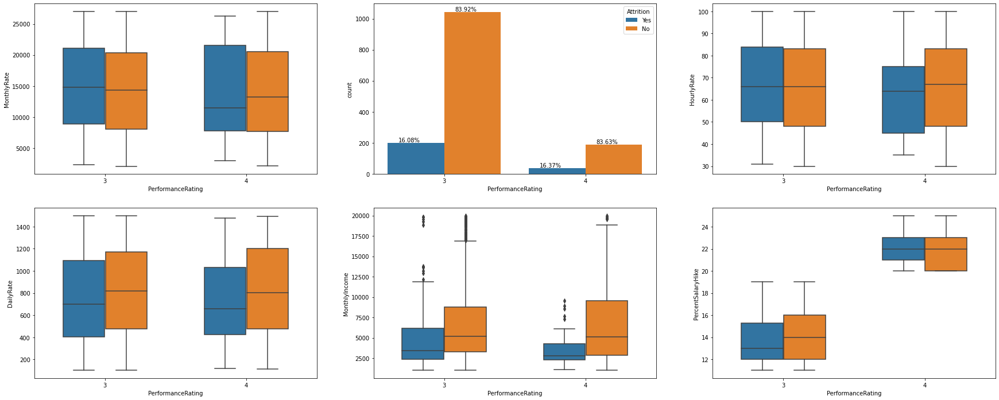

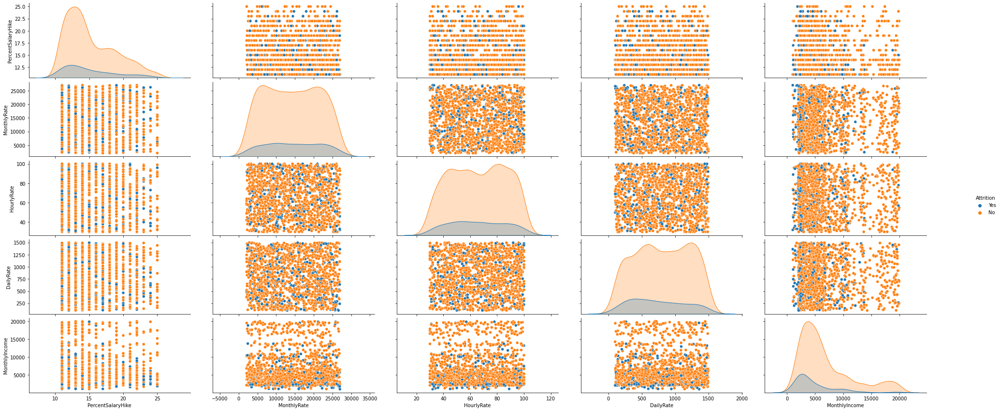

In [18]:
income = ["PercentSalaryHike", 
          "MonthlyRate",
          "HourlyRate",
          "DailyRate",
          "MonthlyIncome",
          "PerformanceRating",
          "Attrition"]
fig, axes = plt.subplots(2, 3, figsize=(30,12))
axes = axes.flatten()
sns.boxplot(x="PerformanceRating", y="MonthlyRate", hue="Attrition", 
    width=0.6, data=data, ax=axes[0])
# label the countplot with percentages within group
# 
ax = sns.countplot(x="PerformanceRating", hue="Attrition", fill=True, 
            data=data, ax=axes[1])

totalThree = len(data.loc[data['PerformanceRating'] == 3, :])
totalFour = len(data.loc[data['PerformanceRating'] == 4, :])

for p, t in zip(ax.patches, [totalThree, totalFour, totalThree, totalFour]):
    print(p, t)
    percentage = '{:.2f}%'.format(100 * p.get_height()/t)
    x = p.get_x() + p.get_width()/2 - 0.125
    y = p.get_y() + p.get_height() + 5
    ax.annotate(percentage, (x, y))

sns.boxplot(x="PerformanceRating", y="HourlyRate", hue="Attrition", 
    width=0.6, data=data, ax=axes[2])
sns.boxplot(x="PerformanceRating", y="DailyRate", hue="Attrition", 
    width=0.6, data=data, ax=axes[3])
sns.boxplot(x="PerformanceRating", y="MonthlyIncome", hue="Attrition", 
    width=0.6, data=data, ax=axes[4])
sns.boxplot(x="PerformanceRating", y="PercentSalaryHike", hue="Attrition", 
    width=0.6, data=data, ax=axes[5])

# remove all legends
for ax in axes:
    ax.legend([],[], frameon=False)

# add back legend to the countplot at middle
axes[1].legend(title="Attrition")
plt.show()


income.remove("PerformanceRating")
pair = sns.pairplot(data[income], diag_kind='kde', hue='Attrition')
pair.fig.set_size_inches(30, 12)

The boxplots show that the income features with respect to 'PerformanceRating' show no outliers with the exception of 'MonthlyIncome' where outliers are present due to income gaps between employees. We show the scatter plots to see if there are any outliers with the data in terms of clustering. From visual inspection, these scatter plots tell us that there are no outliers in the data for the corresponding features compared in the graphs. 

# C. Data Engineering


## One-hot encoding
We first one-hot encoded the non-numeric features, which included the following features: BusinessTravel, Department, EducationField, JobRole, and MaritalStatus.

In [19]:
from sklearn.preprocessing import LabelEncoder
nnum_features = features.select_dtypes(include=[object])
print("Features of type object: ", nnum_features.columns)
le = LabelEncoder()
enc_nnum_features = nnum_features.apply(le.fit_transform)

enc_nnum_features = enc_nnum_features[['Gender', 'OverTime']]

cols = ['BusinessTravel', 'Department', 'EducationField', 'JobRole', 'MaritalStatus']
dummies = pd.get_dummies(features[cols], prefix=cols)

# combine encoded dataframe with original
cat1 = features.select_dtypes(exclude=[object])
print("Before one-hot encoded features: ", features.shape)
u_features = pd.concat([cat1, enc_nnum_features, dummies], axis=1)
print("After one-hot encoded features: ", features.shape)
u_features.info()

Features of type object:  Index(['BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole',
       'MaritalStatus', 'OverTime'],
      dtype='object')
Before one-hot encoded features:  (1470, 30)
After one-hot encoded features:  (1470, 30)
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1470 entries, 0 to 1469
Data columns (total 49 columns):
 #   Column                             Non-Null Count  Dtype
---  ------                             --------------  -----
 0   Age                                1470 non-null   int64
 1   DailyRate                          1470 non-null   int64
 2   DistanceFromHome                   1470 non-null   int64
 3   Education                          1470 non-null   int64
 4   EnvironmentSatisfaction            1470 non-null   int64
 5   HourlyRate                         1470 non-null   int64
 6   JobInvolvement                     1470 non-null   int64
 7   JobLevel                           1470 non-null   int64
 8   JobSatisfaction 

## Feature creation
We decided to agglomerate the three satisfaction features (EnvironmentSatisfaction, JobSatisfaction, RelationshipSatisfaction) into one overall satisfaction index. We did this by replacing the three columns with a new column that contained the sum of those columns. We did this because it reduced the number of features in our dataset while still giving us a measure for each employee's overall satisfaction.

In [20]:
# create overall satisfaction index
def calc_satisfaction(row):
  return row['JobSatisfaction'] + row['EnvironmentSatisfaction'] + row['RelationshipSatisfaction']

u_features['OverallSatisfaction'] = u_features.apply (lambda row: calc_satisfaction(row), axis=1)
u_features.head()
remove_cols = ['JobSatisfaction', 'EnvironmentSatisfaction', 'RelationshipSatisfaction']
u_features.drop(remove_cols, axis=1, inplace=True)
u_features.head()

,Age,DailyRate,DistanceFromHome,Education,HourlyRate,JobInvolvement,JobLevel,MonthlyIncome,MonthlyRate,NumCompaniesWorked,...,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,OverallSatisfaction
0,41,1102,1,2,94,3,2,5993,19479,8,...,0,0,0,0,1,0,0,0,1,7
1,49,279,8,1,61,2,2,5130,24907,1,...,0,0,0,1,0,0,0,1,0,9
2,37,1373,2,2,92,2,1,2090,2396,6,...,0,0,0,0,0,0,0,0,1,9
3,33,1392,3,4,56,3,1,2909,23159,1,...,0,0,0,1,0,0,0,1,0,10
4,27,591,2,1,40,3,1,3468,16632,9,...,0,0,0,0,0,0,0,1,0,7


## Binning
We binned certain features to reduce runtime for the models. 'Age' was binned because employees in certain age groups are likely to share similar traits. We binned employees by age into the following age groups: '18-24’, ‘25-34’, ‘35-45’, ‘45-55’, ‘56+’. 

The rate and income features were binned since after analysis these features provided little information to justify a higher resolution.

In [21]:
# Bin features
bin_values = ['Age', 'DailyRate', 'HourlyRate', 'MonthlyIncome', 'MonthlyRate']
bin_features = u_features.copy()
for b in bin_values:
  min = u_features[b].min()
  max = u_features[b].max()
  # print(min, max)
  width = (max-min)/5
  bins = [-np.inf, min+width, min+width*2, min+width*3, min+width*4, np.inf]
  bin_features[b] = np.digitize(u_features[b], bins, right=True)

bin_features.head()

,Age,DailyRate,DistanceFromHome,Education,HourlyRate,JobInvolvement,JobLevel,MonthlyIncome,MonthlyRate,NumCompaniesWorked,...,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,OverallSatisfaction
0,3,4,1,2,5,3,2,2,4,8,...,0,0,0,0,1,0,0,0,1,7
1,4,1,8,1,3,2,2,2,5,1,...,0,0,0,1,0,0,0,1,0,9
2,3,5,2,2,5,2,1,1,1,6,...,0,0,0,0,0,0,0,0,1,9
3,2,5,3,4,2,3,1,1,5,1,...,0,0,0,1,0,0,0,1,0,10
4,2,2,2,1,1,3,1,1,3,9,...,0,0,0,0,0,0,0,1,0,7


# D. Model Experimentation
We chose to test the following classification models:
- Naive Bayes 
- K Nearest Neighbor (KNN)
- Multilayer Perceptron (MLP)
- AdaBoost
- Support Vector Machine (SVM)
- Stochastic Gradient Descent Classifier (SGDClassifier)
- Decision Tree
- Random Forest

During our data exploration, we noticed there was a class imbalance. While there were 1,233 records for employees that did not leave the company, only 237 employees left the company. To address this imbalance, we also used the Synthetic Minority Oversampling Technique (SMOTE) provided by the imblearn package, which creates pseudo employees records, with each model and evaluated the changes in accuracy, recall, and precision.

## Naive Bayes 
We tested with Naive Bayes since it doesn't suffer from the curse of high dimensionality.

In [77]:
model = imPipeline([
                  ('sampling', SMOTE()),
                  ('classification', GaussianNB())
                  ])
bayes = GaussianNB()
bayes_pred1 = cross_val_predict(bayes, bin_features, labels, cv=10, n_jobs=-1, method='predict_proba', verbose=1)
print("Naive Bayes without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in bayes_pred1[:, 1] ]
print(sk.metrics.classification_report(labels, pred))

bayes_pred2 = cross_val_predict(model, bin_features, labels, cv=10, n_jobs=-1, method='predict_proba', verbose=1)
print("Naive Bayes with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in bayes_pred2[:, 1] ]
print(sk.metrics.classification_report(labels, pred))

Naive Bayes without SMOTE
              precision    recall  f1-score   support

          No       0.93      0.65      0.76      1233
         Yes       0.29      0.75      0.42       237

    accuracy                           0.66      1470
   macro avg       0.61      0.70      0.59      1470
weighted avg       0.83      0.66      0.71      1470

Naive Bayes with SMOTE
              precision    recall  f1-score   support

          No       0.90      0.64      0.75      1233
         Yes       0.26      0.64      0.37       237

    accuracy                           0.64      1470
   macro avg       0.58      0.64      0.56      1470
weighted avg       0.80      0.64      0.69      1470

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:    0.0s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent 

 Overall, Naive Bayes showed difficulties in the recall score for employees who did not leave as well as for the precision score for those who did leave IBM, leading to a low overall accuracy for the dataset. 

## K Nearest Neighbors
We tested the dataset with a K-Nearest-Neighbors (KNN) classifier here. 

In [28]:
# Perform KNN
scaler = StandardScaler()
pca = PCA()
knn = KNeighborsClassifier()
pipeline = Pipeline(steps=[('scaler', scaler), ('pca', pca), ('knn', knn)])
param_grid = {
    'pca__n_components': list(range(10, 31, 5)),
    'knn__n_neighbors': list(range(5, 36, 5))
}
grid = GridSearchCV(pipeline, param_grid, cv=5, n_jobs=-1)
knn_pred1 = cross_val_predict(grid, bin_features, labels, cv=10, n_jobs=-1, method='predict_proba', verbose=1)
print("KNN without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in knn_pred1[:, 1]]
print(sk.metrics.classification_report(labels, pred))

grid.fit(bin_features, labels)
print(grid.best_params_)

pipeline = imPipeline(steps=[('scaler', scaler), ('smote', SMOTE()), ('pca', pca), ('knn', knn)])
grid = GridSearchCV(pipeline, param_grid, cv=5, n_jobs=-1)
knn_pred2 = cross_val_predict(grid, bin_features, labels, cv=10, n_jobs=-1, method='predict_proba', verbose=1)
print("KNN with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in knn_pred2[:, 1]]
print(sk.metrics.classification_report(labels, pred))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:    6.0s remaining:   23.8s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    6.3s finished
KNN without SMOTE
              precision    recall  f1-score   support

          No       0.86      0.99      0.92      1233
         Yes       0.70      0.16      0.27       237

    accuracy                           0.85      1470
   macro avg       0.78      0.58      0.59      1470
weighted avg       0.83      0.85      0.81      1470

{'knn__n_neighbors': 15, 'pca__n_components': 25}
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:    7.4s remaining:   29.7s
KNN with SMOTE
              precision    recall  f1-score   support

          No       0.90      0.67      0.77      1233
         Yes       0.26      0.60      0.36       237

    accuracy                           

KNN performed well with the data with respect to the precision and recall for employees who did not leave IBM. For employees who did leave, the precision score was much less than the same score for those who did not leave, and the recall score for employees who left was also very low, making this classifier bad at determining those who won't actually leave the company (Type II error). 

## Multi-layer Perceptron
We test the dataset using a Multi-layer Perceptron (MLP) Classifier here. We decided to test this model since MLPs are capable of learning complex and diverse decision boundaries from the data. 

In [56]:
scaler = StandardScaler(with_mean=False, with_std=True)
nn = MLPClassifier()
param_grid = {
    'nn__hidden_layer_sizes': [(x, ) for x in range(60, 101, 5)],
    'nn__activation': ['logistic', 'tanh', 'relu'],
    'nn__learning_rate_init': [.001, .003, .005, .007],
    'nn__learning_rate': ['constant', 'invscaling', 'adaptive']
}
pipeline = Pipeline(steps=[('scaler', scaler), ('nn', nn)])
grid = GridSearchCV(pipeline, param_grid=param_grid, cv=5, n_jobs=-1)
nn_pred1 = cross_val_predict(grid, bin_features, labels, cv=10, n_jobs=-1, verbose=1, method='predict_proba')
print("MLP without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in nn_pred1[:, 1]]
print(sk.metrics.classification_report(labels, pred))

grid.fit(bin_features, labels)
print(grid.best_params_)

pipeline = imPipeline(steps=[('scaler', scaler), ('smote', SMOTE()), ('nn', nn)])
grid = GridSearchCV(pipeline, param_grid=param_grid, cv=5, n_jobs=-1)
nn_pred2 = cross_val_predict(grid, bin_features, labels, cv=10, n_jobs=-1, verbose=1, method='predict_proba')
print("MLP with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in nn_pred2[:, 1]]
print(sk.metrics.classification_report(labels, pred))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed: 38.5min remaining: 153.9min
MLP without SMOTE
              precision    recall  f1-score   support

          No       0.90      0.96      0.93      1233
         Yes       0.70      0.45      0.55       237

    accuracy                           0.88      1470
   macro avg       0.80      0.71      0.74      1470
weighted avg       0.87      0.88      0.87      1470

[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed: 38.7min finished
/home/daniel/.local/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
{'nn__activation': 'logistic', 'nn__hidden_layer_sizes': (95,), 'nn__learning_rate': 'adaptive', 'nn__learning_

As expected, the MLP classifier obtains a high score for the precision and recall of those employees who leave IBM. However, just like most of the classfiers we will look at, they suffer from a poor performance relative to the recall score for employees who do leave IBM. 

## Support Vector Machine
We tested the dataset using a Support Vector Machine (SVM) Classifier here. We expected it to perform well on our dataset compared to classfiers such as Naive Bayes and KNN due to SVM's effectiveness with high dimensional datasets. 

In [29]:
scaler = StandardScaler()
pca = PCA()
svm = SVC(probability=True)

param_grid = {
    'pca__n_components': list(range(15, 45)),
    'svm__kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'svm__C': [0.1, 0.5, 1, 2]
}

pipe = Pipeline(steps = [('scaler', scaler), ('pca', pca), ('svm', svm)])
grid = GridSearchCV(pipe, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
svm_pred1 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', verbose=1, n_jobs=-1)
print("SVM without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in svm_pred1[:, 1]]
print(sk.metrics.classification_report(labels, pred))

grid.fit(bin_features, labels)
print(grid.best_params_)

pipe = imPipeline(steps=[('smote', SMOTE()), ('scaler', scaler), ('pca', pca), ('svm', svm)])
grid = GridSearchCV(pipe, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
svm_pred2 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', verbose=1, n_jobs=-1)
print("SVM with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in svm_pred2[:, 1]]
print(sk.metrics.classification_report(labels, pred))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:  1.3min remaining:  5.0min
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  1.3min finished
SVM without SMOTE
              precision    recall  f1-score   support

          No       0.88      0.98      0.93      1233
         Yes       0.80      0.32      0.45       237

    accuracy                           0.88      1470
   macro avg       0.84      0.65      0.69      1470
weighted avg       0.87      0.88      0.85      1470

{'pca__n_components': 29, 'svm__C': 0.5, 'svm__kernel': 'linear'}
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:  3.2min remaining: 12.7min
SVM with SMOTE
              precision    recall  f1-score   support

          No       0.88      0.94      0.91      1233
         Yes       0.53      0.32      0.40       237

    accuracy           

The SVM classifier obtained a high precision and recall score for employees who did not leave IBM as well as a high precision for those who did leave. However, like many of the models tested, it did poorly in determining who will actually leave IBM and had a low recall score or high Type II error for those who will actually leave IBM. 

## Stochastic Gradient Descent Classifier
SGDClassifier is a generalized linear classifier that will use Stochastic Gradient Descent as a solver. With SGDClassifier you can use lots of different loss functions that allows you to tune your model and find the best model for your data. Since SVM performed well, we believed SGDClassifier would also perform similarly. 

In [58]:
scaler = StandardScaler()
sgd = SGDClassifier()
param_grid = {
    'sgd__loss': ['log', 'modified_huber', 'squared_hinge', 'perceptron'],
    'sgd__penalty': ['l2', 'l1', 'elasticnet'],
    'sgd__class_weight': [None, 'balanced'],
    'sgd__max_iter': [500, 1000, 2000],
    'sgd__early_stopping': [True, False],
    'sgd__alpha': [.0001, .001, .01, .1],
    
}

pipe = Pipeline(steps = [('scaler', scaler), ('sgd', sgd)])
grid = GridSearchCV(pipe, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
sgd_pred1 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', n_jobs=-1, verbose=1)
print("SGD without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in sgd_pred1[:, 1]]
print(sk.metrics.classification_report(labels, pred))

grid.fit(bin_features, labels)
print(grid.best_params_)

pipe = imPipeline(steps = [('smote', SMOTE()), ('scaler', scaler), ('sgd', sgd)])
grid = GridSearchCV(pipe, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
sgd_pred2 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', n_jobs=-1, verbose=1)
print("SGD with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in sgd_pred2[:, 1]]
print(sk.metrics.classification_report(labels, pred))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:  1.1min remaining:  4.2min
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  1.1min finished
SGD without SMOTE
              precision    recall  f1-score   support

          No       0.89      0.98      0.93      1233
         Yes       0.76      0.35      0.48       237

    accuracy                           0.88      1470
   macro avg       0.82      0.66      0.71      1470
weighted avg       0.87      0.88      0.86      1470

{'sgd__alpha': 0.01, 'sgd__class_weight': None, 'sgd__early_stopping': False, 'sgd__loss': 'log', 'sgd__max_iter': 1000, 'sgd__penalty': 'elasticnet'}
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:  2.3min remaining:  9.1min
SGD with SMOTE
              precision    recall  f1-score   support

          No       0.89      0.96      0.93    

SGDClassifier's results place it as another top performing model based on it's precision and recall score for those employees who do not leave IBM, but still performs poorly in terms of identifying those employees who actually leave IBM based on those records' recall and precision score. 

## Decision Tree
We tested the data with a DecisionTree Classifier since it is one of the most interpretable models for classification.

In [61]:
param_grid = {
    'max_depth': list(range(35, 55, 1)),
    'min_samples_leaf': list(range(1, 45, 1)),
    'max_features': ['sqrt', 'log2']
}

grid = GridSearchCV(DecisionTreeClassifier(), param_grid, scoring="accuracy", cv=5, n_jobs=-1)
dt_pred1 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', n_jobs=-1, verbose=1)
print("DecisionTree without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in dt_pred1[:, 1]]
print(sk.metrics.classification_report(labels, pred))
grid.fit(bin_features, labels)
print(grid.best_params_)
param_grid = {
    'dt__max_depth': list(range(35, 55, 1)),
    'dt__min_samples_leaf': list(range(1, 45, 1)),
    'dt__max_features': ['sqrt', 'log2']
}

pipe = imPipeline(steps=[('smote', SMOTE()), ('dt', DecisionTreeClassifier())])
grid = GridSearchCV(pipe, param_grid, scoring="accuracy", cv=5, n_jobs=-1)
dt_pred2 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', n_jobs=-1, verbose=1)
print("DecisionTree with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in dt_pred2[:, 1]]
print(sk.metrics.classification_report(labels, pred))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:  1.2min remaining:  5.0min
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  1.3min finished
DecisionTree without SMOTE
              precision    recall  f1-score   support

          No       0.86      0.96      0.90      1233
         Yes       0.43      0.16      0.23       237

    accuracy                           0.83      1470
   macro avg       0.64      0.56      0.57      1470
weighted avg       0.79      0.83      0.80      1470

{'max_depth': 44, 'max_features': 'sqrt', 'min_samples_leaf': 32}
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:  4.6min remaining: 18.5min
DecisionTree with SMOTE
              precision    recall  f1-score   support

          No       0.87      0.79      0.83      1233
         Yes       0.26      0.40      0.32       237

    a

To preface, saying no all the time for the dataset would obtain a score of 83.8%. With this knowledge in mind, the DecisionTree Classifier has poor performance as it doesn't compensate well for the 'Yes' class. This could be due to the data having few features with strong distinctions between those who leave IBM and those who don't, making it hard for the Decision Tree to determing good features to create splits on. 

### Visualizing Decision Tree
To understand why the Decision Tree Classifier performs poorly, we wrote the following code block to visualize the classifier. 

In [27]:
param_grid = {
    'max_depth': list(range(35, 56, 1)),
    'min_samples_leaf': list(range(1, 45, 1)),
    'max_features': ['sqrt', 'log2']
}

grid = GridSearchCV(DecisionTreeClassifier(), param_grid, scoring="accuracy", cv=5, n_jobs=-1)
grid.fit(bin_features, labels)
print(grid.best_params_)
keys = grid.best_params_.keys()
params = {}
for k in keys:
    params[k[:]] = grid.best_params_[k]



estimator = DecisionTreeClassifier(**params)
estimator.fit(bin_features, labels)

# Look at decision tree
from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = bin_features.columns.to_list(),
                class_names = ["Attrited", "Not Attrited"],
                rounded = True, proportion = False, 
                precision = 2, filled = True)


# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
display(Image(filename = 'tree.png'))

{'max_depth': 48, 'max_features': 'sqrt', 'min_samples_leaf': 26}


The decision tree classifier relies on a metric of impurity called the gini, such that the goal of the tree is to split on the best feature that results in the largest information gain, or equivalently the largest difference between the gini before and after the split. In other words, we want purer subsets that ideally should be composed of either all attritions or all none attritions. Looking at the image, we see that most splits actually result in very small reductions in gini, or might even increase the impurity. This provides further evidence that our decision tree is struggling to find features that can distinguish employees who left the company from those who didn’t. In fact, examining the leaves (blue) that results in a prediction for ‘No’ attrition, we see that the gini for those leaves are very close to 0.5, which means that the tree is really just guessing with both ‘Yes’ and ‘No’ being equally likely despite prior splits.

## Random Forest
Random Forest Classifiers are a collection of numerous Decision Trees combined with randomness towards how the splits per tree are determined. This classifier can account for more complex patterns in the data using a voting scheme as well as help reduce overfitting to the data compared to singular Decision Trees with its inclusion of a stochastic factor. 

In [69]:
param_grid = {
    'max_depth': list(range(90, 106, 5)),
    'min_samples_leaf': list(range(1, 22, 2))
}

grid = GridSearchCV(RandomForestClassifier(n_jobs=-1), param_grid, scoring="accuracy", cv=5, n_jobs=-1)
rf_pred1 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', n_jobs=-1, verbose=1)
print("RandomForest without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in rf_pred1[:, 1]]
print(sk.metrics.classification_report(labels, pred))

grid.fit(bin_features, labels)
print(grid.best_params_)

param_grid = {
    'rf__max_depth': list(range(90, 106, 5)),
    'rf__min_samples_leaf': list(range(1, 22, 2))
}

pipe = imPipeline(steps=[('smote', SMOTE(n_jobs=-1)), ('rf', RandomForestClassifier(n_jobs=-1))])
grid = GridSearchCV(pipe, param_grid, scoring="accuracy", cv=5, n_jobs=-1)
rf_pred2 = cross_val_predict(grid, bin_features, labels, cv=10, method='predict_proba', n_jobs=-1, verbose=1)
print("RandomForest with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in rf_pred2[:, 1]]
print(sk.metrics.classification_report(labels, pred))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:   53.8s remaining:  3.6min
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   54.5s finished
RandomForest without SMOTE
              precision    recall  f1-score   support

          No       0.86      0.99      0.92      1233
         Yes       0.84      0.18      0.30       237

    accuracy                           0.86      1470
   macro avg       0.85      0.59      0.61      1470
weighted avg       0.86      0.86      0.82      1470

{'max_depth': 100, 'min_samples_leaf': 1}
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:  1.1min remaining:  4.3min
RandomForest with SMOTE
              precision    recall  f1-score   support

          No       0.87      0.96      0.91      1233
         Yes       0.55      0.25      0.35       237

    accuracy                 

Random Forest performed better than Decision Tree, however, the tradeoff of interpretebility and duration for training the between the Random Forest and Decision Tree classifier for the small performance gain by the former is disappointing.

### Visualizing feature importances
To understand each features' contributions towards the Random Forest Classifier's predictions, we wrote the following code block to graph their importance obtained from the classifier. 

{'max_depth': 45, 'max_features': 'sqrt', 'min_samples_leaf': 5}


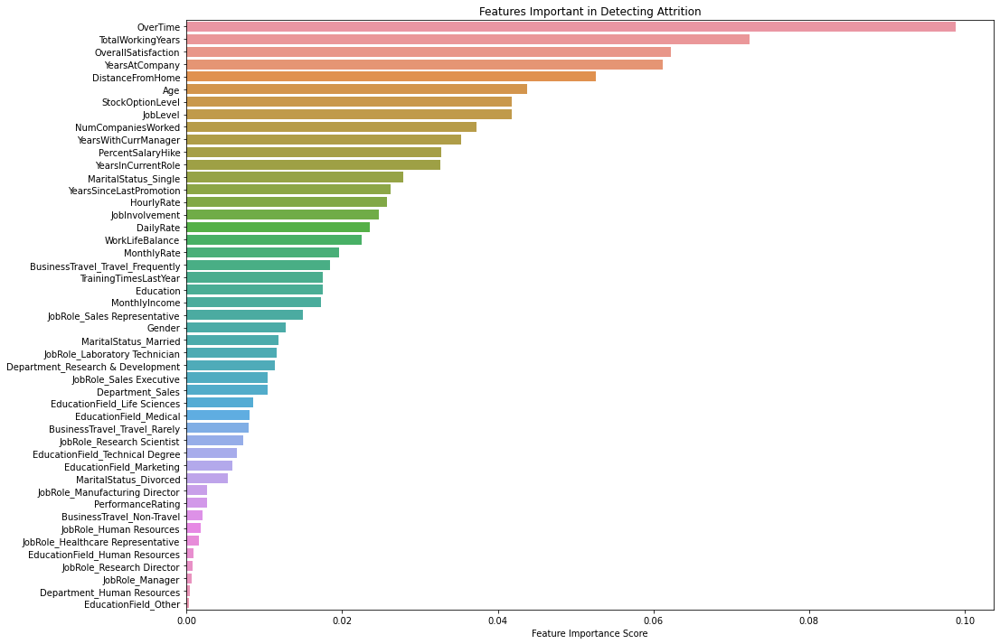

In [24]:
param_grid = {
    'max_depth': list(range(35, 55+1, 5)),
    'min_samples_leaf': list(range(1, 22, 2)),
    'max_features': ['sqrt', 'log2']
}

grid = GridSearchCV(RandomForestClassifier(), param_grid, scoring="accuracy", cv=5, n_jobs=-1)
grid.fit(bin_features, labels)
print(grid.best_params_)
estimator = RandomForestClassifier(**grid.best_params_)
estimator.fit(bin_features, labels)

# take the top 20 most important features
feature_imp = pd.Series(
    estimator.feature_importances_, index=bin_features.columns
).sort_values(ascending=False)

%matplotlib inline
fig, axes = plt.subplots(1, figsize=(16, 12))
# Creating a bar plot
sns.barplot(x=feature_imp, y=feature_imp.index, ax=axes)
plt.xlabel('Feature Importance Score')
plt.title("Features Important in Detecting Attrition")
plt.show()

From the graph, we learn that the features 'OverTime', 'TotalWorkingYears', 'OverallSatisfaction', 'YearsAtCompany', and 'Age' are interpreted by the Random Forest Classifier as the ones with the highest importance. Also, the graph reveals how each job role varies in importance with the 'Sales Representative' role being many times more important than the 'Research Director'. This is consistent with our graphs earlier of the relationship between job role and attrition count.  

## AdaBoost
AdaBoost uses the boosting strategy to improve classifiers' classification score. We used AdaBoost on the top 3 classifiers tested prior that performed the best: MLP, SGD, and SVM. 

In [73]:
pipe1 = Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA(n_components=29)), ('svc', SVC(C=.5, kernel='linear'))])
pipe2 = Pipeline(steps=[('scaler', StandardScaler()), ('sgd', SGDClassifier(class_weight=None, early_stopping=False, alpha=.01, loss='log', max_iter=1000, penalty='elasticnet'))])
nn = MLPClassifier(activation='logistic',  hidden_layer_sizes=(95,), learning_rate='adaptive', learning_rate_init=.001)

pipe3 = Pipeline(steps=[('scaler', scaler), ('nn', nn)])
param_grid = {
    'learning_rate': [.001, .002, .003, .004, .005],
    'base_estimator': [DecisionTreeClassifier(max_depth=15, max_features='sqrt', min_samples_leaf=26), pipe1, pipe2]
    }


ada = AdaBoostClassifier()
grid = GridSearchCV(ada, param_grid, cv=5, n_jobs=-1)
ada_pred1 = cross_val_predict(grid, bin_features, labels, cv=10, n_jobs=-1, verbose=1, method='predict_proba')
print("AdaBoost without SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in ada_pred1[:, 1]]
print(sk.metrics.classification_report(labels, pred))


param_grid = {
    'ada__learning_rate': [.001, .002, .003, .004, .005],
    'ada__base_estimator': [DecisionTreeClassifier(max_depth=15, max_features='sqrt', min_samples_leaf=26), pipe1, pipe2]
        }

pipe = imPipeline(steps=[('smote', SMOTE(n_jobs=-1)), ('ada', ada)])
grid = GridSearchCV(pipe, param_grid, cv=5, n_jobs=-1)
ada_pred2 = cross_val_predict(grid, bin_features, labels, cv=10, n_jobs=-1, verbose=1, method='predict_proba')
print("AdaBoost with SMOTE")
pred = ["Yes" if v >= 0.5 else "No" for v in ada_pred2[:, 1]]
print(sk.metrics.classification_report(labels, pred))


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:    4.1s remaining:   16.5s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    4.4s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
AdaBoost without SMOTE
              precision    recall  f1-score   support

          No       0.85      1.00      0.92      1233
         Yes       0.95      0.08      0.14       237

    accuracy                           0.85      1470
   macro avg       0.90      0.54      0.53      1470
weighted avg       0.86      0.85      0.79      1470

AdaBoost with SMOTE
              precision    recall  f1-score   support

          No       0.89      0.92      0.90      1233
         Yes       0.48      0.39      0.43       237

    accuracy                           0.83      1470
   macro avg       0.68      0.66      0.67      1470
weighted avg       0.82      0.83      0.83      147

As expected, AdaBoost did increase some of the metrics for scoring such as recall for 'No', increasing it all the way to 100%, however, this was at the cost of the recall for 'Yes,' giving a score of 8%, which is the worst out of all the classifiers. Overall, AdaBoost improves all other metrics at the cost of the recall for 'Yes'. Unfortunately, this is the metric that we care the most about since we want to predict which employees will leave and do not want to misclassify them. 

# E. Conclusion

## Plotting ROC
We made three figures to summarize the results across all of our classifiers. The first graph graphs the ROC curves for each of our classifiers, SMOTE and Non-SMOTE, along with their AUC value. 

AUC is an area under the Receiver Operating Characteristic (ROC) curve, which plots the true positive rate against the false positive rate at various probability thresholds used to determine whether an employee has attributed. The closer the curve is to the upper-left corner, the better the model is performing to distinguish between attrited employees and not attrited employees, resulting in a higher AUC. Hence, we also plotted the ROC curves for each of our classifiers on the same plot so that we can easily spot the best classifier by this criteria. 

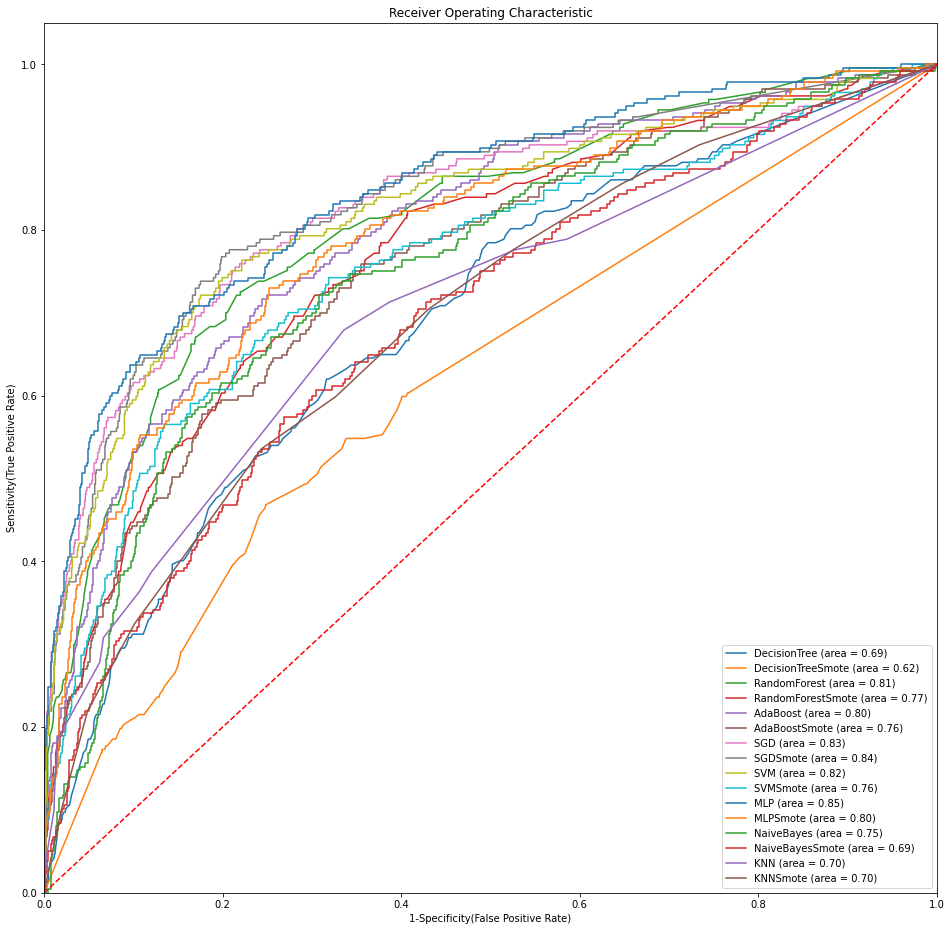

In [88]:
# Add the models to the list that you want to view on the ROC plot
models = {
    'DecisionTree': {'type': 'DecisionTree', 'pred': dt_pred1}, 
    'DecisionTreeSmote': {'type': 'DecisionTree', 'pred': dt_pred2},
    'RandomForest': {'type': 'RandomForest', 'pred': rf_pred1},
    'RandomForestSmote': {'type': 'RandomForest', 'pred': rf_pred2},
    'AdaBoost': {'type': 'AdaBoost', 'pred': ada_pred1},
    'AdaBoostSmote': {'type': 'AdaBoost', 'pred': ada_pred2},
    'SGD': {'type': 'SGD', 'pred': sgd_pred1},
    'SGDSmote': {'type': 'SGD', 'pred': sgd_pred2},
    'SVM': {'type': 'SVM', 'pred': svm_pred1},
    'SVMSmote': {'type': 'SVM', 'pred': svm_pred2},
    'MLP': {'type': 'MLP', 'pred': nn_pred1},
    'MLPSmote': {'type': 'MLP', 'pred': nn_pred2},
    'NaiveBayes': {'type': 'NaiveBayes', 'pred': bayes_pred1},
    'NaiveBayesSmote': {'type': 'NaiveBayes', 'pred': bayes_pred2},
    'KNN': {'type': 'KNN', 'pred': knn_pred1}, 
    'KNNSmote': {'type': 'KNN', 'pred': knn_pred2}
}

# plot the AUCs
fig, axs = plt.subplots(1, figsize=(16, 16))
for m in models:
    pred_proba = models[m]['pred'][:, 1]
    pred = ["Yes" if v >= 0.5 else "No" for v in pred_proba]
    # Compute False postive rate, and True positive rate
    fpr, tpr, thresholds = roc_curve(labels, pred_proba, pos_label='Yes')
    # Calculate Area under the curve to display on the plot
    auc = roc_auc_score(labels, pred_proba)
    # Now, plot the computed values
    plt.plot(fpr, tpr, label='%s (area = %0.2f)' % (m, auc))


# Custom settings for the plot 

plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('1-Specificity(False Positive Rate)')
plt.ylabel('Sensitivity(True Positive Rate)')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()   # Display

From the graph, we see that MLP has the highest performance with the highest AUC value of .85 while DecisionTree with and without SMOTE had the lowest AUC values of .69 and .62, respectively. 

In [89]:
# construct the dataframe for seaborn to make grouped bars
# 3 variables: model type, score type, actual score
computeScores = [
    'accuracy',
    'f1',
    'precision',
    'recall',
    'AUC'
]

name = []
modelTypes = []
isSmote = []
scoreTypes = []
actualScores = []

# for every model, for every score type, compute the score
for m in models:
    pred_proba = models[m]['pred'][:, 1]
    pred = [ "Yes" if v >= 0.5 else "No" for v in pred_proba ]
    
    for s in computeScores:
        scoreTypes.append(s)
        name.append(m)
        modelTypes.append(models[m]['type'])
        if 'Smote' in m:
            isSmote.append(True)
        else:
            isSmote.append(False)

        v = -1
        if s == "accuracy":
            v = accuracy_score(labels, pred)
        elif s == "f1":
            v = f1_score(labels, pred, pos_label="Yes")
        elif s == "precision":
            v = precision_score(labels, pred, pos_label="Yes")
        elif s == "recall":
            v = recall_score(labels, pred, pos_label="Yes")
        elif s == "AUC":
            v = roc_auc_score(labels, pred_proba)
        actualScores.append(v)

len(modelTypes) == len(scoreTypes)
len(modelTypes) == len(actualScores)

metricDF = pd.DataFrame(
    {
        'modelTypes':modelTypes,
        'scoreTypes':scoreTypes,
        'actualScores':actualScores,
        'isSmote': isSmote,
        'name': name
    }
)

metricDF

,modelTypes,scoreTypes,actualScores,isSmote,name
0,DecisionTree,accuracy,0.829932,False,DecisionTree
1,DecisionTree,f1,0.228395,False,DecisionTree
2,DecisionTree,precision,0.425287,False,DecisionTree
3,DecisionTree,recall,0.156118,False,DecisionTree
4,DecisionTree,AUC,0.694151,False,DecisionTree
...,...,...,...,...,...
75,KNN,accuracy,0.661224,True,KNNSmote
76,KNN,f1,0.363171,True,KNNSmote
77,KNN,precision,0.260550,True,KNNSmote
78,KNN,recall,0.599156,True,KNNSmote


The first is a grouped bar chart comparing various metrics across each model, namely their accuracies, precisions, recalls, f1 scores, and Area Under the Curve (AUC) scores. Precision, or the number of true positives over the sum of true positives and false positives, answers the question that given a positive prediction from the classifier, how likely is it to be correct. Recall, or the number of true positives over the sum of true positives and false negatives, answers the question that given a positive example, will our classifier detect it. But there’s a precision-recall tradeoff, so that we can use the f1-score, or a harmonic mean between precision and recall, to compare across classifiers instead. Finally, the AUC is a measure of the degree of separability, where the higher the AUC, the higher the true positive and true negative rate (and thus better performance). Therefore, we want to maximize all of these metrics, so that we can directly compare bar heights to find the best classifiers within each metric. 

<AxesSubplot:xlabel='name', ylabel='actualScores'>

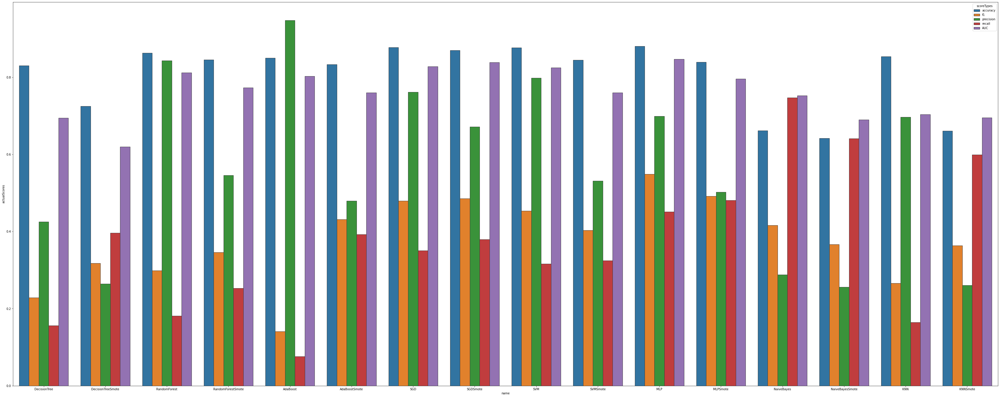

In [92]:
fig, axes = plt.subplots(1, figsize=(60, 24))
sns.barplot(x="name", y="actualScores", hue="scoreTypes", 
            data=metricDF, ax=axes, errcolor=".2", edgecolor=".2")

### Slope-graph
To evaluate how SMOTE affected our results, we created a slopegraph to highlight the change across our evaluation metrics.

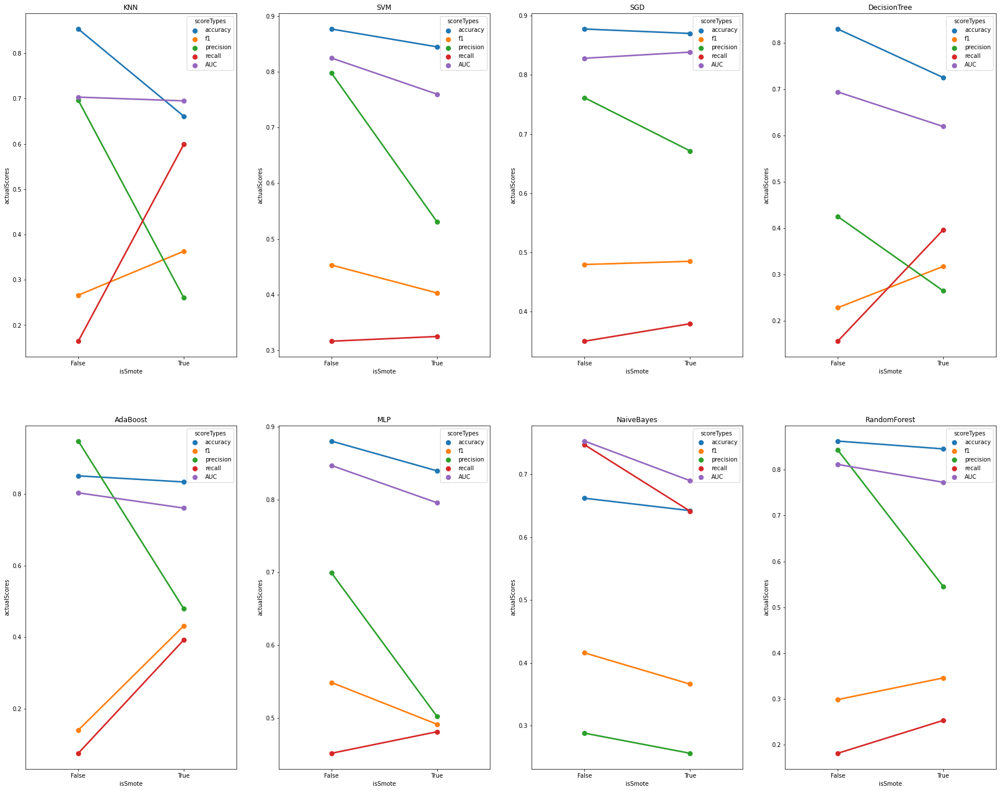

In [93]:
# slope graph of smote versus not change for all models
# PUT NUMBER OF CLASSIFIERS HERE
fig, axes = plt.subplots(2, 4, figsize=(30,24))
axes = axes.flatten()
for i, m in enumerate(set(metricDF['modelTypes'])):
    filtered = metricDF.loc[metricDF['modelTypes'] == m, :]

    sns.pointplot(x="isSmote", y="actualScores", hue="scoreTypes",
                  data=filtered, ax=axes[i]).set_title(filtered['name'].values[0])
plt.show()

#### Selecting a classifier
Based on the slope-graph, we can identify Naive Bayes Classifier as the one with the highest recall score for employees who did leave IBM, however, it does perform poorly with respect to the other metrics compared to some of the other classifiers. Despite this fact, if we were choosing a classifier to provide us the best prediction of whether an employee would leave, Naive Bayes would be the one. 

If we were using accuracy as the sole metric for selecting a classifier, MLP would be the best classifier according to the group bargraph. However, MLP suffers from a low recall for the 'Yes' class and has large variances in its precision, recall, and F1 scores, which lead us to pick SGD and SVM as the best overall classifier judging by the bargraph since they do not have the same variations in scores as MLP and still provide a high accuracy that is very close to MLP. 
#### SMOTE vs Non-SMOTE
The comparison between classifiers with and without SMOTE might indicate that SMOTE cannot function well for high dimensional data. The recall for minor class increases a little bit at the cost of the precision for the minor class and recall for the major class drops drastically. SMOTE does not fully solve the class imbalance problem. Future work would include finding other methods to deal with the class imbalance problem for high dimensional data.